-Notebook comprenant :

    -
    -
    -

In [ ]:

# Python3 program to find the  
# Surface area of a 3D figure 
  
  
# Declaring the size  
# of the matrix 
M = 3; 
N = 3; 
  
# Absolute Difference  
# between the height of 
# two consecutive blocks 
def contribution_height(current, previous): 
    return abs(current - previous); 
  
# Function To calculate  
# the Total surfaceArea. 
def surfaceArea(A): 
    ans = 0; 
  
    # Traversing the matrix. 
    for i in range(N):  
        for j in range(M): 
  
            # If we are traveling the 
            # topmost row in the matrix, 
            # we declare the wall above it  
            # as 0 as there is no wall  
            # above it. 
            up = 0; 
  
            # If we are traveling the 
            # leftmost column in the  
            # matrix, we declare the wall  
            # left to it as 0 as there is 
            # no wall left it.  
            left = 0; 
  
            # If its not the topmost row 
            if (i > 0): 
                up = A[i - 1][j]; 
  
            # If its not the  
            # leftmost column 
            if (j > 0): 
                left = A[i][j - 1]; 
  
            # Summing up the  
            # contribution of by 
            # the current block 
            ans += contribution_height(A[i][j], up)+contribution_height(A[i][j], left); 
              
            # If its the rightmost block  
            # of the matrix it will contribute  
            # area equal to its height as a 
            # wall on the right of the figure */ 
            if (i == N - 1): 
                ans += A[i][j]; 
  
            # If its the lowest block  
            # of the matrix it will  
            # contribute area equal to  
            # its height as a wall on  
            # the bottom of the figure 
            if (j == M - 1): 
                ans += A[i][j]; 
  
    # Adding the contribution by  
    # the base and top of the figure 
    ans += N * M * 2; 
    return ans; 
  
# Driver Code 
A = [[1, 3, 4],[2, 2, 3],[1, 2, 4]]; 
print(surfaceArea(A)); 
  
# This code is contributed By mits 


# Importer les libraries

In [2]:
import sys
#sys.path.append("/usr/local/lib/python3.6/dist-packages/")
#sys.path.append("/usr/local/lib/python2.7/dist-packages/")
import geoio
from PIL import Image
import numpy as np
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
from skimage import filters, segmentation
from skimage.measure import label
import pandas as pd
import seaborn as sns
from scipy import stats
from PIL.TiffTags import TAGS
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, viewer, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc
#import utm
#import geopandas as gpd
from shapely.geometry import shape
import rasterio.features
import gdal
from matplotlib.offsetbox import AnchoredText
from matplotlib.offsetbox import TextArea, VPacker, AnnotationBbox

/home/anne-sophie/anaconda3/envs/new_gdal/lib/python3.7/site-packages/skimage/viewer/utils/core.py:10: UserWarning:

Recommended matplotlib backend is `Agg` for full skimage.viewer functionality.



# Meta data, figures

In [3]:
path = '/home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/'
filename = ['odm_orthophoto_optique_1.tif','odm_orthophoto_thermique_1.tif','odm_orthophoto_optique_zone2.tif','odm_orthophoto_thermique_zone2.tif']

In [9]:
path+filename[0][:-3]

'/home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophoto_optique_1.'

In [30]:
#meta
img_th_meta = geoio.GeoImage(path+filename[3])
img_op_meta = geoio.GeoImage(path+filename[2])

## Sauvegarder images optique et thermique zone 2 

In [26]:
im = Image.open(path+filename[2])
matrice_im = np.array(im)
im.save(str(filename[2][::-4])+'.png')

In [27]:
im = Image.open(path+filename[3])
matrice_im = np.array(im)
im.save(str(filename[3][::-4])+'.png')

## Meta données des images 

### Données optique

In [31]:
img_op_meta

Class Name        : GeoImage
Driver Name       : GTiff
Data Type         : Byte
File Name         : /home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophoto_
                    optique_zone2.tif
File List         : ['/home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophot
                    o_optique_zone2.tif']
Dimensions        : (4, 7448, 6279) (nlayers, nrows, ncols)
Resolution        : (0.09793172604861423, 0.09793096890981258) (x,y)
Extent            : (472107.8215835418, 4651728.46473419, 472837.2170791519,
                    4651113.556180405) (ul_x, ul_y, lr_x, lr_y)
Projection String : PROJCS["WGS 84 / UTM zone 32N",
                     GEOGCS["WGS 84",
                         DATUM["WGS_1984",
                             SPHEROID["WGS 84",6378137,298.257223563,
                                 AUTHORITY["EPSG","7030"]],
                             AUTHORITY["EPSG","6326"]],
                         PRIMEM["Greenwich",0,
                             AUTHORITY["EP

### Données thermiques

In [37]:
img_op_meta

Class Name        : GeoImage
Driver Name       : GTiff
Data Type         : Byte
File Name         : /home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophoto_
                    optique_zone2.tif
File List         : ['/home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophot
                    o_optique_zone2.tif']
Dimensions        : (4, 7448, 6279) (nlayers, nrows, ncols)
Resolution        : (0.09793172604861423, 0.09793096890981258) (x,y)
Extent            : (472107.8215835418, 4651728.46473419, 472837.2170791519,
                    4651113.556180405) (ul_x, ul_y, lr_x, lr_y)
Projection String : PROJCS["WGS 84 / UTM zone 32N",
                     GEOGCS["WGS 84",
                         DATUM["WGS_1984",
                             SPHEROID["WGS 84",6378137,298.257223563,
                                 AUTHORITY["EPSG","7030"]],
                             AUTHORITY["EPSG","6326"]],
                         PRIMEM["Greenwich",0,
                             AUTHORITY["EP

### Parametres des donnees géoréférencées

In [45]:
pixel_resolution_th = img_th_meta.meta['resolution']
pixel_resolution_op = img_op_meta.meta['resolution']

Les données optiques ont une résolution de :
    - GT(1) = 0.09793172604861423 m (width)
    - GT(5) = -0.09793096890981258 m (height)
Les données thermiques ont une résolution de :
    - GT(1) = 0.23842204422588367 m (width)
    - GT(5) = -0.23844284372087618 m (height)

Les données géotransformées sont :
$$ X_{geo} = GT(0) + Xpixel*GT(1) = GT(3) + Xpixel*GT(4)$$

(GT(0),GT(3)) position is the top left corner of the top left pixel of the raster.
In case of north up images,the GT(2) and GT(4) coefficients are zero, and the GT(1) is pixel width, and GT(5) is pixel height. 

### Convertir l'image en matrice 

In [14]:
#Open the image and find the corresponding values
img_th = Image.open(path+filename[1])
matrices = np.array(img_th)

In [16]:
im = Image.open(path+filename[1])
matrice_im = np.array(im)
im.save(str(filename[1][::-4])+'.png')

### Changer l'encodage

In [17]:
#Convert in HSV
im_hsv = im.convert('HSV')
matrice_hsv = np.array(im_hsv)

In [18]:
#Convert in grayscale
im_g=im.convert('L')
matrice_g = np.array(im.convert('L'))

# Separabilité des différentes classes 

In [71]:
'''
Fonction to plot the distribution
of each canal RGB of the picture 
.tif 
'''

def distrib_plot(tif,name):
    #plt.clf()
    #tif = Image.open(fig)
    tif_RGB = tif.convert('RGB')
    matrice = (np.array(tif_RGB))
    r = pd.DataFrame(np.ravel(matrice[:,:,0]))
    g = pd.DataFrame(np.ravel(matrice[:,:,1]))
    b = pd.DataFrame(np.ravel(matrice[:,:,2]))
    sns.distplot(r,color='r', label = 'Canal Red')
    sns.distplot(g,color='g', label = 'Canal Green')
    sns.distplot(b,color='b', label = 'Canal Blue')
    h = pd.DataFrame({'Red':np.ravel(matrice[:,:,0])})
    s = pd.DataFrame({'Green':np.ravel(matrice[:,:,1])})
    v = pd.DataFrame({'Blue':np.ravel(matrice[:,:,2])})
    #df2 = pd.DataFrame(np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]]),columns=['a', 'b', 'c'])
    hdf = h.describe()
    modehdf = pd.DataFrame(h.mode())
    hdf1 = pd.concat([hdf, modehdf])
    sdf = s.describe()
    modesdf = pd.DataFrame(s.mode())
    sdf1 = pd.concat([sdf, modesdf])
    vdf = v.describe()
    modevdf = pd.DataFrame(v.mode())
    vdf1 = pd.concat([vdf, modevdf])
    df2 = pd.concat([hdf1,sdf1,vdf1],axis=1)
    ax = plt.gca()
    plt.legend()
    plt.title(name)
    plt.savefig(name + '.png')
    return df2

In [74]:
def stat_plot_rgb(df2,plt):
    ax = plt.gca()
    texts = ['Canals  Mean  std','Red : ' + str(round(df2.loc['mean'][0])) + '  ' +str(round(df2.loc['std'][0])),'Green : ' + str(round(df2.loc['mean'][1])) +'  '+str(round(df2.loc['std'][1])), 'Blue : '
            + str(round(df2.loc['mean'][2])) +'  '+str(round(df2.loc['std'][2]))]
    colors = ['black','red','green','blue']
    Texts = []
    for t,c in zip(texts,colors):
        Texts.append(TextArea(t,textprops=dict(color=c)))
    texts_vbox = VPacker(children=Texts,pad=0,sep=0)
    ann = AnnotationBbox(texts_vbox,(0.6,0.5),xycoords=ax.transAxes,
                                box_alignment=(0,.5),bboxprops = 
                                dict(facecolor='wheat',boxstyle='square',color='white'))
    ann.set_figure(fig)
    fig.artists.append(ann)

In [ ]:
def stat_plot(df2,plt):
    ax = plt.gca()
    texts = ['Canals  Mean  std','Hue : ' + str(round(df2.loc['mean'][0])) + '  ' +str(round(df2.loc['std'][0])),'Saturation : ' + str(round(df2.loc['mean'][1])) +'  '+str(round(df2.loc['std'][1])), 'Value : '
            + str(round(df2.loc['mean'][2])) +'  '+str(round(df2.loc['std'][2]))]
    colors = ['black','red','green','blue']
    Texts = []
    for t,c in zip(texts,colors):
        Texts.append(TextArea(t,textprops=dict(color=c)))
    texts_vbox = VPacker(children=Texts,pad=0,sep=0)
    ann = AnnotationBbox(texts_vbox,(0.6,0.5),xycoords=ax.transAxes,
                                box_alignment=(0,.5),bboxprops = 
                                dict(facecolor='wheat',boxstyle='square',color='white'))
    ann.set_figure(fig)
    fig.artists.append(ann)

In [53]:
'''
Fonction to plot the distribution 
of each canal HSV of the picture 
.tif 
'''
def distrib_plot_hsv(tif,name):
    #plt.clf()
    #tif = Image.open(fig)
    tif_RGB = tif.convert('HSV')
    matrice = (np.array(tif_RGB))
    r = pd.DataFrame(np.ravel(matrice[:,:,0]))
    g = pd.DataFrame(np.ravel(matrice[:,:,1]))
    b = pd.DataFrame(np.ravel(matrice[:,:,2]))
    sns.distplot(r,color='r', label = 'Canal Hue')
    sns.distplot(g,color='g', label = 'Canal Saturation')
    sns.distplot(b,color='b', label = 'Canal Value')
    #plt.legend()
    plt.title(name)
    #plt.savefig(name + 'hsv.png')
    h = pd.DataFrame({'Hue':np.ravel(matrice[:,:,0])})
    s = pd.DataFrame({'Saturation':np.ravel(matrice[:,:,1])})
    v = pd.DataFrame({'Value':np.ravel(matrice[:,:,2])})
    #df2 = pd.DataFrame(np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]]),columns=['a', 'b', 'c'])
    hdf = h.describe()
    modehdf = pd.DataFrame(h.mode())
    hdf1 = pd.concat([hdf, modehdf])
    sdf = s.describe()
    modesdf = pd.DataFrame(s.mode())
    sdf1 = pd.concat([sdf, modesdf])
    vdf = v.describe()
    modevdf = pd.DataFrame(v.mode())
    vdf1 = pd.concat([vdf, modevdf])
    df2 = pd.concat([hdf1,sdf1,vdf1],axis=1)
    ax = plt.gca()
    '''texts = ['alpha','beta','epsilon']
    colors = ['red','cyan','black']
    Texts = []
    for t,c in zip(texts,colors):
        Texts.append(TextArea(t,textprops=dict(color=c)))
    texts_vbox = VPacker(children=Texts,pad=0,sep=0)
    ann = AnnotationBbox(texts_vbox,(.02,.5),xycoords=ax.transAxes,
                                box_alignment=(0,.5),bboxprops = 
                                dict(facecolor='wheat',boxstyle='round',color='black'))
    ann.set_figure(fig)
    fig.artists.append(ann)'''
    return df2

## Différencier la végétation, la route, la mer etc

In [50]:
features = ['Terre']
arbre1 = gdal.Open('../data_features/Arbres_Eparses/ae_01.tif')
arbre2 = gdal.Open('../data_features/Arbres_Eparses/ae_02.tif')
Terre1 = gdal.Open('../data_features/Terre/terre_01.tif')
Terre1 = gdal.Open('../data_features/Terre/terre_02.tif')

In [51]:
arbre1 = Image.open('../data_features/Arbres_Eparses/ae_01.tif')
arbre2 = Image.open('../data_features/Arbres_Eparses/ae_02.tif')
Terre1 = Image.open('../data_features/Terre/terre_01.tif')
Terre2 = Image.open('../data_features/Terre/terre_02.tif')
Foret_dense1 = Image.open('../data_features/Foret_dense/Foret_dense_01.tif')
Foret_dense2 = Image.open('../data_features/Foret_dense/Foret_dense_02.tif')
mer1 = Image.open('../data_features/Mer/mer_01.tif')
mer2 = Image.open('../data_features/Mer/mer_02.tif')
mer3 = Image.open('../data_features/Mer/mer_03.tif')
mer4 = Image.open('../data_features/Mer/mer_04.tif')
figs = [arbre1,arbre2,Terre1,Terre2]

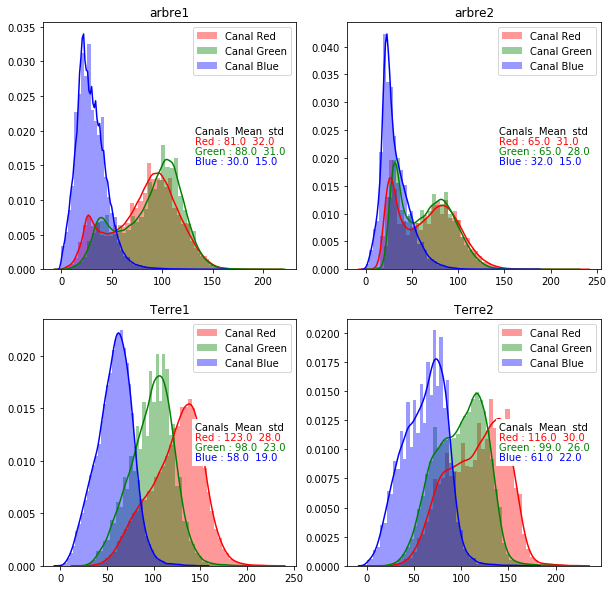

In [75]:
figs = [arbre1,arbre2,Terre1,Terre2]
fig = plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
df2 = distrib_plot(arbre1,'arbre1')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,2)
df2 = distrib_plot(arbre2,'arbre2')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,3)
df2 = distrib_plot(Terre1,'Terre1')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,4)
df2 = distrib_plot(Terre2,'Terre2')
stat_plot_rgb(df2,plt)

## Caractéristique de la zone brûlée 

### Sur encodage RGB

In [ ]:
#zb1_th = Image.open('../data_features/Arbres_Eparses/ae_01.tif')
#zb2_th = Image.open('../data_features/Arbres_Eparses/ae_01.tif')

In [61]:
zb1_o = Image.open('../data_features/Zone_b/odm_orthophoto_optique_zone2_ba_1')
zb2_o = Image.open('../data_features/Zone_b/odm_orthophoto_optique_zone2_ba_2')

In [63]:
def stat_plot(df2,plt):
    ax = plt.gca()
    texts = ['Canals  Mean  std','Hue : ' + str(round(df2.loc['mean'][0])) + '  ' +str(round(df2.loc['std'][0])),'Saturation : ' + str(round(df2.loc['mean'][1])) +'  '+str(round(df2.loc['std'][1])), 'Value : '
            + str(round(df2.loc['mean'][2])) +'  '+str(round(df2.loc['std'][2]))]
    colors = ['black','red','green','blue']
    Texts = []
    for t,c in zip(texts,colors):
        Texts.append(TextArea(t,textprops=dict(color=c)))
    texts_vbox = VPacker(children=Texts,pad=0,sep=0)
    ann = AnnotationBbox(texts_vbox,(0.6,0.5),xycoords=ax.transAxes,
                                box_alignment=(0,.5),bboxprops = 
                                dict(facecolor='wheat',boxstyle='square',color='white'))
    ann.set_figure(fig)
    fig.artists.append(ann)

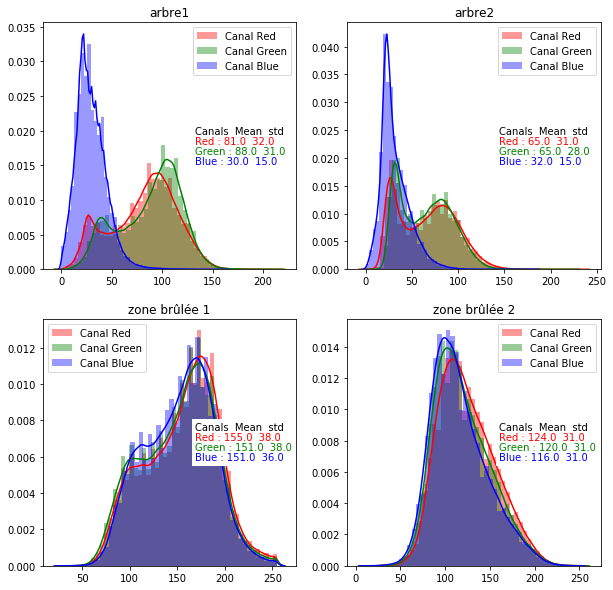

In [76]:
figs = [arbre1,arbre2,zb1_o,zb2_o]
fig = plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
df2 = distrib_plot(arbre1,'arbre1')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,2)
df2 = distrib_plot(arbre2,'arbre2')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,3)
df2 = distrib_plot(zb1_o,'zone brûlée 1')
stat_plot_rgb(df2,plt)
plt.subplot(2,2,4)
df2 = distrib_plot(zb2_o,'zone brûlée 2')
stat_plot_rgb(df2,plt)

### Sur encodage HSV

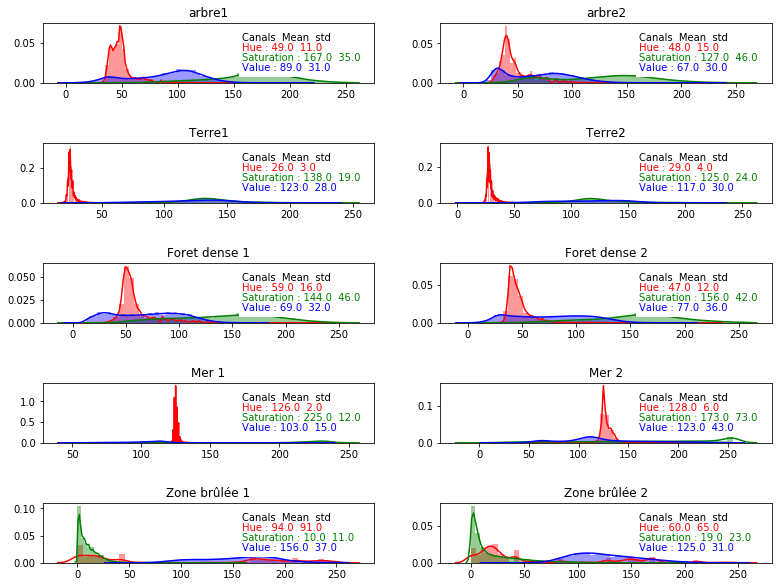

In [80]:
nx = 5
ny = 2
figs = [arbre1,arbre2,Terre1,Terre2]
fig = plt.figure(figsize=(15,15))
plt.subplots_adjust(bottom=2, right=0.8, top=2.5)
plt.subplot(nx,2,1)
df2 = distrib_plot_hsv(arbre1,'arbre1')
stat_plot(df2,plt)

plt.subplot(nx,2,2)
df2 = distrib_plot_hsv(arbre2,'arbre2')
stat_plot(df2,plt)

plt.subplot(nx,2,3)
df2 = distrib_plot_hsv(Terre1,'Terre1')
stat_plot(df2,plt)

plt.subplot(nx,2,4)
df2 = distrib_plot_hsv(Terre2,'Terre2')
stat_plot(df2,plt)

plt.subplot(nx,2,5)
df2 = distrib_plot_hsv(Foret_dense1,'Foret dense 1')
stat_plot(df2,plt)

plt.subplot(nx,2,6)
df2 = distrib_plot_hsv(Foret_dense2,'Foret dense 2')
stat_plot(df2,plt)
            
plt.subplot(nx,2,7)
df2 = distrib_plot_hsv(mer1,'Mer 1')
stat_plot(df2,plt)

plt.subplot(nx,2,8)
df2 = distrib_plot_hsv(mer2,'Mer 2')
stat_plot(df2,plt)
plt.subplots_adjust(hspace=1)

plt.subplot(nx,2,9)
df2 = distrib_plot_hsv(zb1_o,'Zone brûlée 1')
stat_plot(df2,plt)

plt.subplot(nx,2,10)
df2 = distrib_plot_hsv(zb2_o,'Zone brûlée 2')
stat_plot(df2,plt)
plt.subplots_adjust(hspace=1)

In [81]:
plt.savefig("Separability.png")

<Figure size 432x288 with 0 Axes>

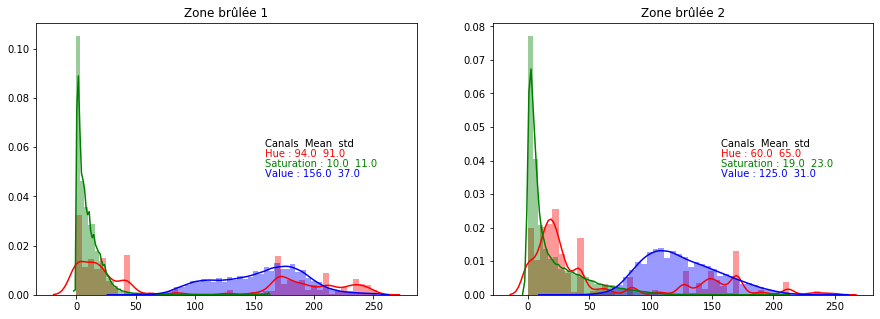

In [88]:
fig = plt.figure(figsize=(15,5))
plt.clf()
plt.subplot(1,2,1)
df2 = distrib_plot_hsv(zb1_o,'Zone brûlée 1')
stat_plot(df2,plt)

plt.subplot(1,2,2)
df2 = distrib_plot_hsv(zb2_o,'Zone brûlée 2')
stat_plot(df2,plt)
plt.subplots_adjust(hspace=1)

In [89]:
plt.savefig("zone_brulee.png")

<Figure size 432x288 with 0 Axes>

# Clustering sur une orthophoto

## Différenciation des classes

In [ ]:
def segmentation(test,i):
    #test = img #Image.open('DiffClasses/dc_07.tif')
    test_HSV = test
    matrice = (np.array(test_HSV))
    h = pd.DataFrame(np.ravel(matrice[:,:,0]))
    s = pd.DataFrame(np.ravel(matrice[:,:,1]))
    v = pd.DataFrame(np.ravel(matrice[:,:,2]))
    img = matrice
    vectorized = img.reshape((-1,3))
    # convert to np.float32
    vectorized = np.float32(vectorized)
    K = 3
    attempts=40
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
    center = np.uint8(center)
    res = center[label.flatten()]
    result_image = res.reshape((img.shape))
    plt.clf()
    figure_size = 15
    plt.figure(figsize=(figure_size,figure_size))
    plt.subplot(1,2,1),plt.imshow(test)
    plt.title('Image Original'), plt.xticks([]), plt.yticks([])
    plt.subplot(1,2,2),plt.imshow(result_image)
    plt.title('Segmentation par clustering avec K = %i' % K), plt.xticks([]), plt.yticks([])
    plt.legend()
    plt.savefig('segmentation de '+str(i)+'.png')
    plt.show()
    return result_image,label

## Déterminer la zone brûlée

In [8]:
#!pip install scikit-learn
import sklearn.cluster
import cv2
import numpy as np
# load the image and grab its width and height
image = cv2.imread(path+filename[3])
(h, w) = image.shape[:2]
 
# convert the image from the RGB color space to the L*a*b*
# color space -- since we will be clustering using k-means
# which is based on the euclidean distance, we'll use the
# L*a*b* color space where the euclidean distance implies
# perceptual meaning
image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
 
# reshape the image into a feature vector so that k-means
# can be applied
image = image.reshape((image.shape[0] * image.shape[1], 3))
 
# apply k-means using the specified number of clusters and
# then create the quantized image based on the predictions
clt = sklearn.cluster.MiniBatchKMeans(n_clusters = 8)
labels = clt.fit_predict(image)
quant = clt.cluster_centers_.astype("uint8")[labels]
 
# reshape the feature vectors to images
quant = quant.reshape((h, w, 3))
image = image.reshape((h, w, 3))
 
# convert from L*a*b* to RGB
quant = cv2.cvtColor(quant, cv2.COLOR_LAB2BGR)
image = cv2.cvtColor(image, cv2.COLOR_LAB2BGR)
 
# display the images and wait for a keypress
#plt.imshow("image", np.hstack([image, quant]))
#cv2.waitKey(0)
cv2.imwrite('segmentationth8_zone2.png',quant)

# Etude de cas

## Données brutes

## Séparabilité des classes 

### Sur les canaux RGB, HSV, indice de végétation

### Avec indice de végétation

In [23]:
import rasterio as rio
import geopandas as gpd
import rasterio as rio
import geopandas as gpd
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
from rasterio.enums import Resampling

In [24]:
with rio.open(path+filename[3]) as src:
    therm_data = src.read()

with rio.open(path+filename[2]) as src:
    opt_data = src.read(out_shape=(therm_data.shape[0], therm_data.shape[1], therm_data.shape[2]),
        resampling=Resampling.average)

# View shape of the data
print(opt_data.shape)
print(therm_data.shape)

(4, 2571, 3082)
(4, 2571, 3082)


In [25]:
def rgb2gray(rgb):
    return 0.2989*rgb[0]+0.5870*rgb[1]+0.1140*rgb[2]

therm_data_gray = rgb2gray(therm_data)
therm_data_gray.shape

(2571, 3082)

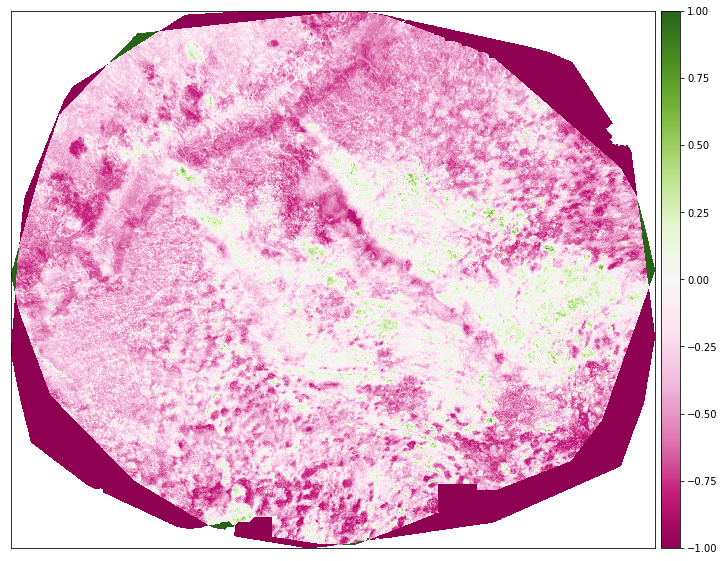

In [27]:
naip_ndvi = es.normalized_diff(therm_data_gray, opt_data[0])
ep.plot_bands(naip_ndvi, cmap='PiYG',
              scale=False,
              vmin=-1, vmax=1)
plt.show()

In [28]:
plt.savefig("indice_de_vegetation.png")

<Figure size 432x288 with 0 Axes>

## Clustering

## Contour avec algorithme de traitement d'image

### Fonctions à utiliser 

In [38]:
def circle_levelset(shape, center, sqradius):
    """Build a binary function with a circle as the 0.5-levelset."""
    grid = np.mgrid[list(map(slice, shape))].T - center
    phi = sqradius - np.sqrt(np.sum((grid.T) ** 2, 0))
    u = np.float_(phi > 0)
    return u

In [37]:
class MultiMorphSnakes(object):
    """
    An extension of having multiple non-overlapping snakes in single image

    >>> np.random.seed(0)
    >>> img = np.random.random((15, 15))
    >>> mask = np.zeros(img.shape, dtype=int)
    >>> mask[2:9, 3:7] = 1
    >>> mask[10:14, 9:12] = 2
    >>> ms = MultiMorphSnakes(img, mask)
    >>> ms.levelset
    array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 0, 0, 0],
           [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]])
    >>> ms.run(1)
    >>> np.array_equal(mask, ms.levelset)
    False
    """

    def __init__(self, image, init_mask, list_snakes=None, list_params=None):
        self._image = np.array(image)
        self._u = init_mask

        inits = np.unique(init_mask)[1:]

        if list_snakes is None:
            list_snakes = [DEFAULT_SNAKE for lb in inits]
        elif not isinstance(list_snakes, list):
            list_snakes = [list_snakes for lb in inits]
        elif len(list_snakes) == 1 and len(inits) > 1:
            list_snakes = [list_snakes[0] for lb in inits]

        if list_params is None:
            list_params = [DEFAULT_PARAMS for lb in inits]
        elif not isinstance(list_params, list):
            list_params = [list_params for lb in inits]
        elif len(list_params) == 1 and len(inits) > 1:
            list_params = [list_params[0] for lb in inits]

        assert len(inits) == len(list_snakes), \
            'not match - inits: %i and snakes: %i' \
            % (len(inits), len(list_snakes))
        assert len(list_snakes) == len(list_params), \
            'not match - snakes: %i and params: %i' \
            % (len(list_snakes), len(list_snakes))

        self._snakes = []
        for lb, snake, params in zip(inits, list_snakes, list_params):
            levelset = (init_mask == lb)
            snake_inst = snake(levelset, self._image, **params)
            self._snakes.append(snake_inst)

    def step(self):
        """ Perform a single step of the morphological Chan-Vese evolution."""
        lvs = []
        for snake in self._snakes:
            snake.step()
            lvs.append(snake.levelset)

        # collision
        mask = np.sum(np.array(lvs), axis=0) > 1
        for snake in self._snakes:
            snake.levelset[mask] = 0

    def get_levelsets(self):
        self._u = np.zeros(self._image.shape, dtype=int)
        for i, snake in enumerate(self._snakes):
            self._u[snake.levelset == 1] = i + 1
        return self._u

    levelset = property(get_levelsets, lambda self: self._u,
                        doc="The level set embedding function (u).")

    def run(self, nb_iters):
        """ Run several nb_iters of the morphological Chan-Vese method."""
        last_segm = np.array(self.levelset)
        for i in range(nb_iters):
            self.step()
            if np.array_equal(last_segm, self.levelset):
                logging.info('no change after %i iterations', i)
                break
            last_segm = np.array(self.levelset)

# levelset = circle_levelset(img.shape, (80, 170), 25)
# macwe = morphsnakes.MorphACWE(levelset, img, smoothing=3,
#                               lambda1=1, lambda2=1)
#
# for i in range(num_iters):
#     # Evolve.
#     msnake.step()
#
#     # Update figure.
#     del ax1.collections[0]
#     ax1.contour(msnake.levelset, [0.5], colors='r')
#     ax_u.set_data(msnake.levelset)
#     fig.canvas.draw()


### Mophological ACWE

In [30]:
PATH_IMG_ISLETS

'/home/anne-sophie/Bureau/ETUDE_DE_CAS_1/Data/odm_orthophoto_thermique_1.tif'

In [46]:
PATH_IMG_ISLETS = path+filename[1]
# Load the image.
resize_value = 1
img_color = plt.imread(PATH_IMG_ISLETS) / 255.0
#img_color = np.array(img_color.resize(0.5))
#img_color = imresize(img_color,resize_value)
img = img_color[:, :, 0]

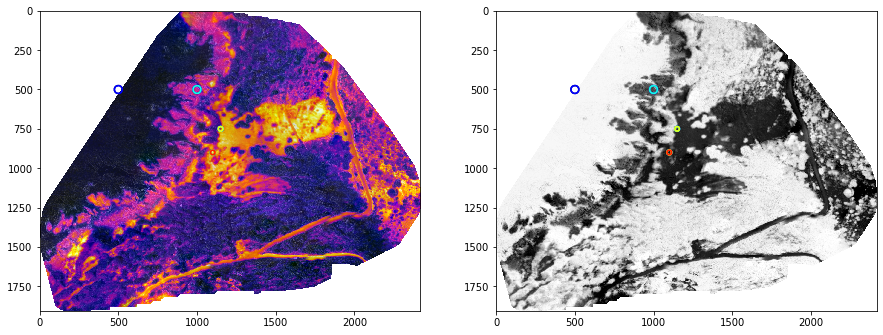

In [47]:

# Load the image.
#img_color = imread(PATH_IMG_LAKES) / 255.0
#img = rgb2gray(img_color)

# Morphological ACWE. Initialization of the level-set.
mask = np.zeros(img.shape, dtype=int)
mask[circle_levelset(img.shape, (500, 500), 25) == 1] = 1
mask[circle_levelset(img.shape, (500, 1000), 25) == 1] = 2
mask[circle_levelset(img.shape, (750, 1150), 15) == 1] = 3
mask[circle_levelset(img.shape, (900, 1100), 15) == 1] = 4
plt.figure(figsize=(15,15))
_= plt.subplot(1, 2, 1), plt.imshow(img_color), plt.contour(mask, cmap=plt.cm.jet) 
_= plt.subplot(1, 2, 2), plt.imshow(img, cmap=plt.cm.Greys), plt.contour(mask, cmap=plt.cm.jet)

In [ ]:
%time
ms = MultiMorphSnakes(img, mask, MorphACWE, 
                               dict(smoothing=3, lambda1=1, lambda2=1))
ms.run(100000)

In [ ]:
plt.figure(figsize=(15,15))
_= plt.imshow(img_color), plt.contour(ms.levelset, colors="cyan")
plt.imshow(img)
plt.savefig("contour2.eps")
plt.savefig("contour2.png")

In [ ]:
pixels = np.ravel(ms.levelset) 
Area =len(np.ravel(np.where(pixels==1)))*pixel_resolution_th[0]*pixel_resolution_th[1]*resize_value

# Deep learning

## Etude de cas sur des données drones en Afrique, utilisation de fastai

## Creation de la base de données d'entrainement

### Annotation tool

### DeepGeoNet (Segnet)

# Indice de Végétation

## Essai à la main

In [18]:
im_th = Image.open(path+filename[1])
im_opt = Image.open(path+filename[0])

In [19]:
size = np.array(im_th).shape
to_resize = size[1],size[0]
to_resize

(2418, 1907)

In [20]:
np.array(im_opt).shape

(5629, 6675, 4)

In [21]:
im_opt_small = im_opt.resize(to_resize)

In [22]:
im_th.tag.tags

{}

In [31]:
np.unique(np.array(im_th)[:,:,3])

array([  0, 255], dtype=uint8)

(1907, 2418, 4)


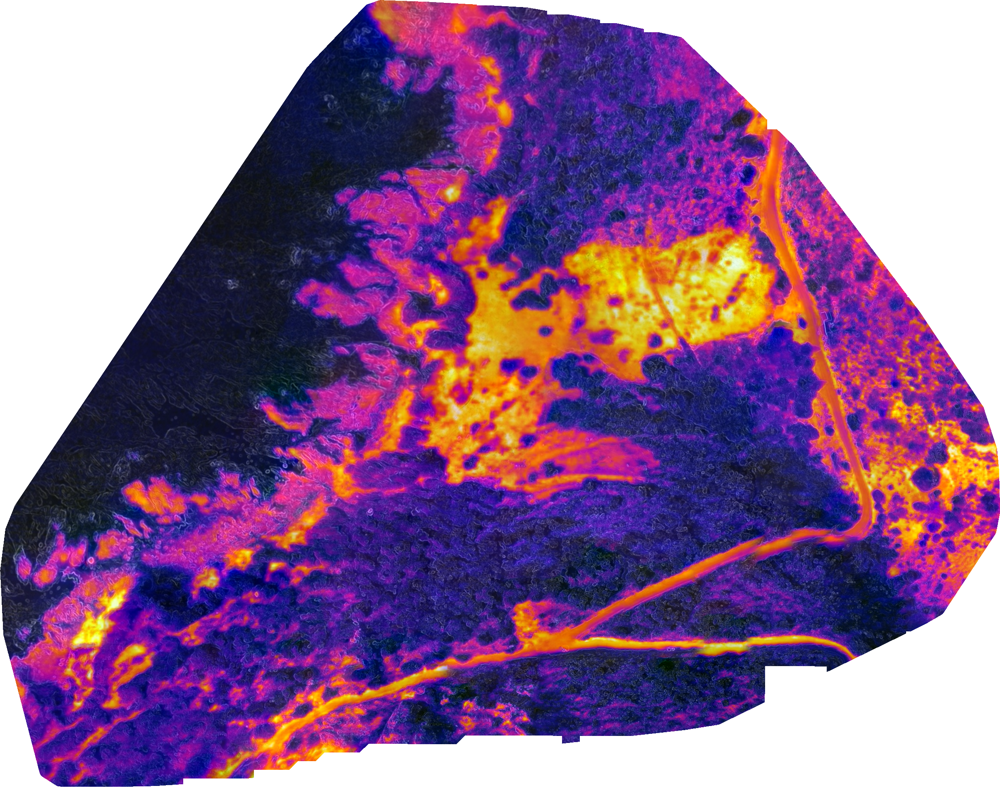

In [122]:
print(np.array(im_th).shape)
im_th

(1907, 2418, 2)


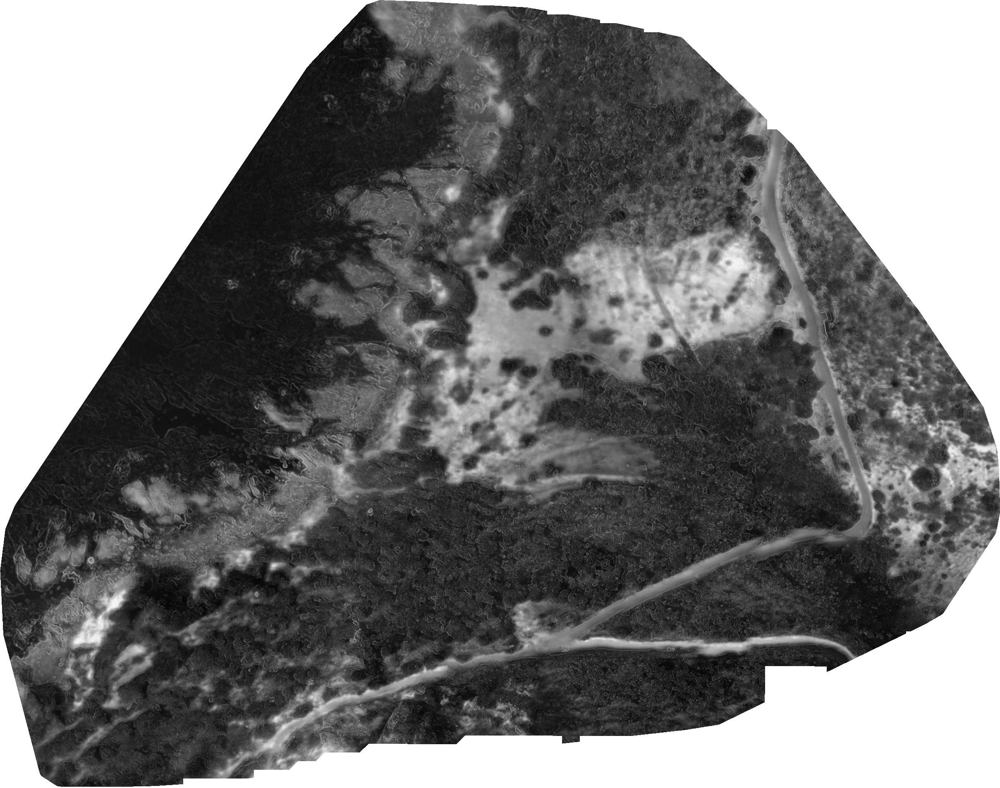

In [121]:
im_th_grayscale = im_th.convert('LA')
print(np.array(im_th_grayscale).shape)
im_th_grayscale

(1907, 2418, 4)


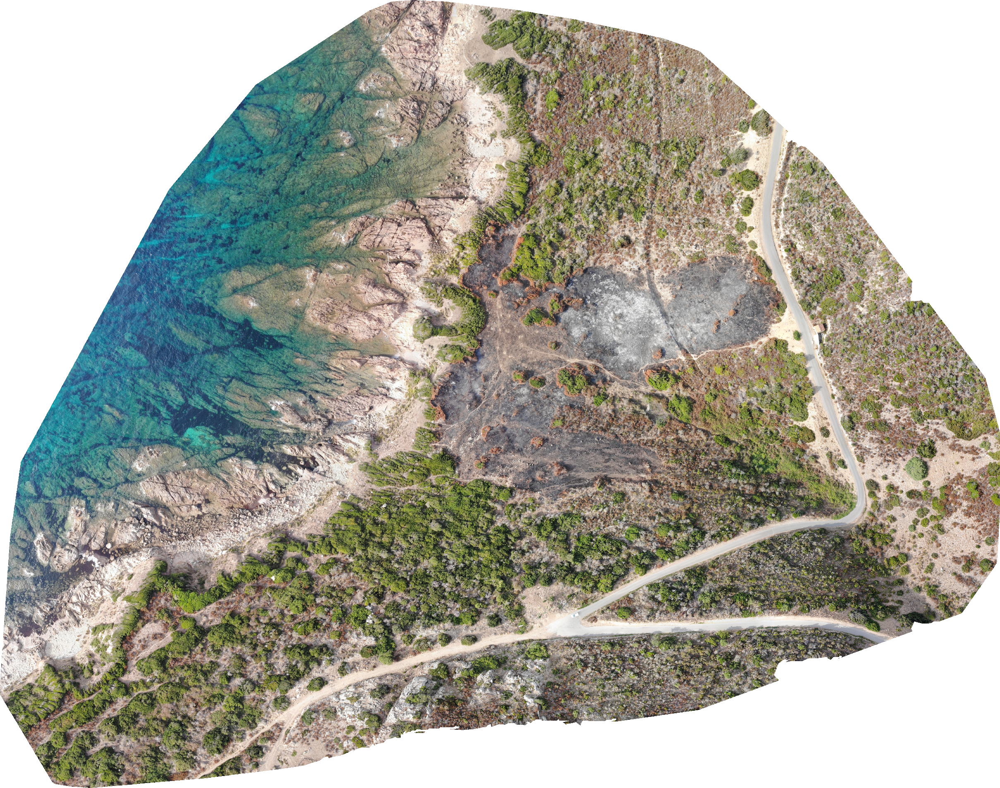

In [123]:
print(np.array(im_opt_small).shape)
im_opt_small

In [130]:
array_th = np.array(im_th_grayscale)
array_opt = np.array(im_opt_small)
old_err_state = np.seterr(divide='raise')
ignored_states = np.seterr(**old_err_state)
vegetation_index = np.divide(array_th[:,:,0] - array_opt[:,:,0], array_th[:,:,0] + array_opt[:,:,0])

/home/anne-sophie/anaconda3/envs/env_geo/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning:

divide by zero encountered in true_divide

/home/anne-sophie/anaconda3/envs/env_geo/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning:

invalid value encountered in true_divide



In [140]:
np.unique(vegetation_index)

array([0.        , 0.00392157, 0.00395257, ...,        nan,        nan,
              nan])

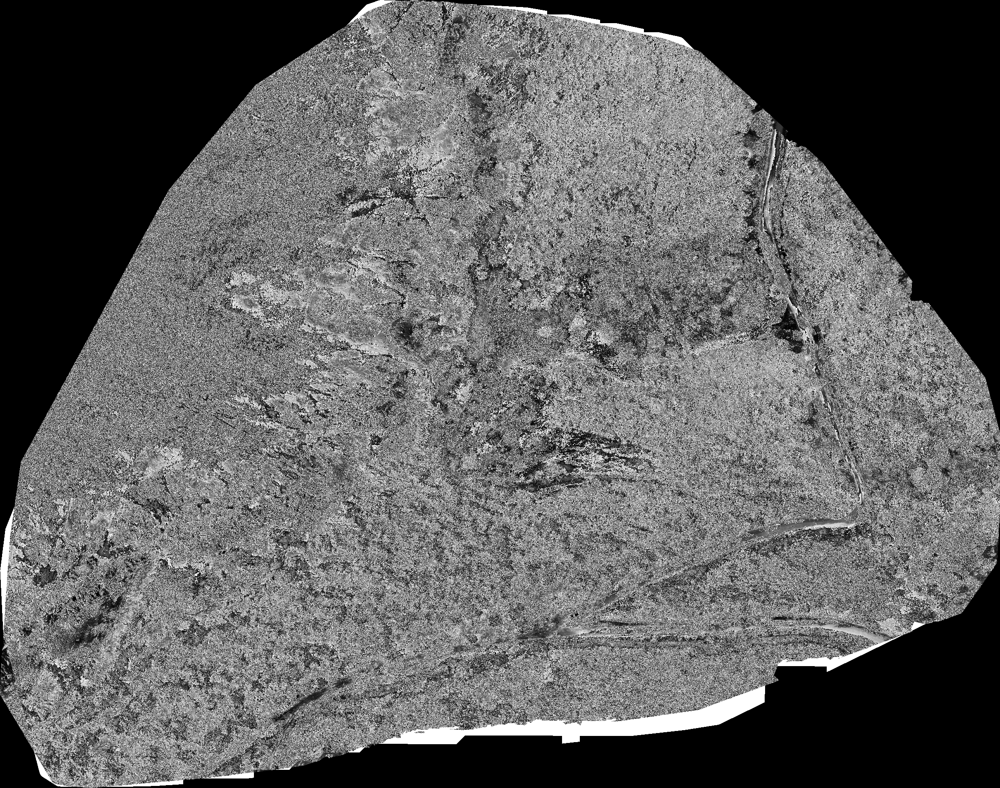

In [135]:
im_vegetation_index = Image.fromarray(np.uint8(vegetation_index*255))
im_vegetation_index

## Essai avec geopy

In [11]:
import rasterio as rio
import geopandas as gpd
sys.path('/home/anne-sophie/anaconda3/pkgs/earthpy-0.7.4-py_0/')
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
from rasterio.enums import Resampling

TypeError: 'list' object is not callable

In [ ]:
with rio.open(path+filename[1]) as src:
    therm_data = src.read()

with rio.open(path+filename[0]) as src:
    opt_data = src.read(out_shape=(therm_data.shape[0], therm_data.shape[1], therm_data.shape[2]),
        resampling=Resampling.average)

# View shape of the data
print(opt_data.shape)
print(therm_data.shape)

In [ ]:
 R +  G +  B

In [ ]:
def rgb2gray(rgb):
    return 0.2989*rgb[0]+0.5870*rgb[1]+0.1140*rgb[2]

therm_data_gray = rgb2gray(therm_data)
therm_data_gray.shape

In [ ]:
naip_ndvi = es.normalized_diff(therm_data_gray, opt_data[0])

In [ ]:
ep.plot_bands(naip_ndvi, cmap='PiYG',
              scale=False,
              vmin=-1, vmax=1)
plt.show()

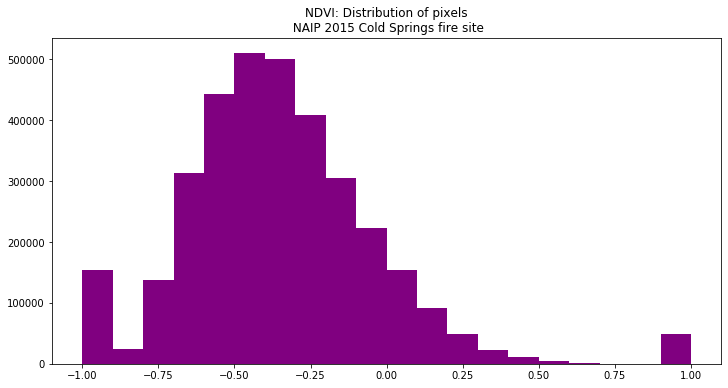

In [77]:
ep.hist(naip_ndvi,
        figsize=(12, 6),
        title=["NDVI: Distribution of pixels\n NAIP 2015 Cold Springs fire site"])
plt.show()


# Analyse

In [43]:
class Cluster(object):

    def __init__(self):
        self.pixels = []
        self.centroid = None

    def addPoint(self, pixel):
        self.pixels.append(pixel)

    def setNewCentroid(self):

        R = [colour[0] for colour in self.pixels]
        G = [colour[1] for colour in self.pixels]
        B = [colour[2] for colour in self.pixels]

        R = np.sum(R) / len(R)
        G = np.sum(G) / len(G)
        B = np.sum(B) / len(B)

        self.centroid = (R, G, B)
        self.pixels = []

        return self.centroid


class Kmeans(object):

    def __init__(self, k=3, max_iterations=5, min_distance=5.0, size=200):
        self.k = k
        self.max_iterations = max_iterations
        self.min_distance = min_distance
        self.size = (size, size)

    def run(self, image):
        self.image = image
        self.image.thumbnail(self.size)
        self.pixels = numpy.array(image.getdata(), dtype=numpy.uint8)

        self.clusters = [None for i in range(self.k)]
        self.oldClusters = None

        randomPixels = random.sample(self.pixels, self.k)

        for idx in range(self.k):
            self.clusters[idx] = Cluster()
            self.clusters[idx].centroid = randomPixels[idx]

        iterations = 0

        while self.shouldExit(iterations) is False:

            self.oldClusters = [cluster.centroid for cluster in self.clusters]

            print(iterations)

            for pixel in self.pixels:
                self.assignClusters(pixel)

            for cluster in self.clusters:
                cluster.setNewCentroid()

            iterations += 1

        return [cluster.centroid for cluster in self.clusters]

    def assignClusters(self, pixel):
        shortest = float('Inf')
        for cluster in self.clusters:
            distance = self.calcDistance(cluster.centroid, pixel)
            if distance < shortest:
                shortest = distance
                nearest = cluster

        nearest.addPoint(pixel)

    def calcDistance(self, a, b):

        result = numpy.sqrt(sum((a - b) ** 2))
        return result

    def shouldExit(self, iterations):

        if self.oldClusters is None:
            return False

        for idx in range(self.k):
            dist = self.calcDistance(
                numpy.array(self.clusters[idx].centroid),
                numpy.array(self.oldClusters[idx])
            )
            if dist < self.min_distance:
                return True

        if iterations <= self.max_iterations:
            return False

        return True

    # ############################################
    # The remaining methods are used for debugging
    def showImage(self):
        self.image.show()

    def showCentroidColours(self):

        for cluster in self.clusters:
            image = Image.new("RGB", (200, 200), cluster.centroid)
            image.show()

    def showClustering(self):

        localPixels = [None] * len(self.image.getdata())

        for idx, pixel in enumerate(self.pixels):
                shortest = float('Inf')
                for cluster in self.clusters:
                    distance = self.calcDistance(
                        cluster.centroid,
                        pixel
                    )
                    if distance < shortest:
                        shortest = distance
                        nearest = cluster

                localPixels[idx] = nearest.centroid

        w, h = self.image.size
        localPixels = numpy.asarray(localPixels)\
            .astype('uint8')\
            .reshape((h, w, 3))

        colourMap = Image.fromarray(localPixels)
        plt.imshow(colourMap)

In [44]:
def segmentation(test,i):
    #test = img #Image.open('DiffClasses/dc_07.tif')
    test_HSV = test
    matrice = (np.array(test_HSV))
    h = pd.DataFrame(np.ravel(matrice[:,:,0]))
    s = pd.DataFrame(np.ravel(matrice[:,:,1]))
    v = pd.DataFrame(np.ravel(matrice[:,:,2]))
    img = matrice
    vectorized = img.reshape((-1,3))
    # convert to np.float32
    vectorized = np.float32(vectorized)
    K = 3
    attempts=40
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_PP_CENTERS)
    center = np.uint8(center)
    res = center[label.flatten()]
    result_image = res.reshape((img.shape))
    plt.clf()
    figure_size = 15
    plt.figure(figsize=(figure_size,figure_size))
    plt.subplot(1,2,1),plt.imshow(test)
    plt.title('Image Original'), plt.xticks([]), plt.yticks([])
    plt.subplot(1,2,2),plt.imshow(result_image)
    plt.title('Segmentation par clustering avec K = %i' % K), plt.xticks([]), plt.yticks([])
    plt.legend()
    plt.savefig('segmentation de '+str(i)+'.png')
    plt.show()
    return result_image,label

In [45]:
# load the image and grab its width and height
image = cv2.imread(path+filename[1])
(h, w) = image.shape[:2]
 
# convert the image from the RGB color space to the L*a*b*
# color space -- since we will be clustering using k-means
# which is based on the euclidean distance, we'll use the
# L*a*b* color space where the euclidean distance implies
# perceptual meaning
image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
 
# reshape the image into a feature vector so that k-means
# can be applied
image = image.reshape((image.shape[0] * image.shape[1], 3))
 
# apply k-means using the specified number of clusters and
# then create the quantized image based on the predictions
clt = sklearn.cluster.MiniBatchKMeans(n_clusters = 8)
labels = clt.fit_predict(image)
quant = clt.cluster_centers_.astype("uint8")[labels]
 
# reshape the feature vectors to images
quant = quant.reshape((h, w, 3))
image = image.reshape((h, w, 3))
 
# convert from L*a*b* to RGB
quant = cv2.cvtColor(quant, cv2.COLOR_LAB2BGR)
image = cv2.cvtColor(image, cv2.COLOR_LAB2BGR)
 
# display the images and wait for a keypress
#cv2.imshow("image", np.hstack([image, quant]))
#cv2.waitKey(0)

In [46]:
cv2.imwrite('segmentationth8.png',quant)

True

<IPython.core.display.Javascript object>


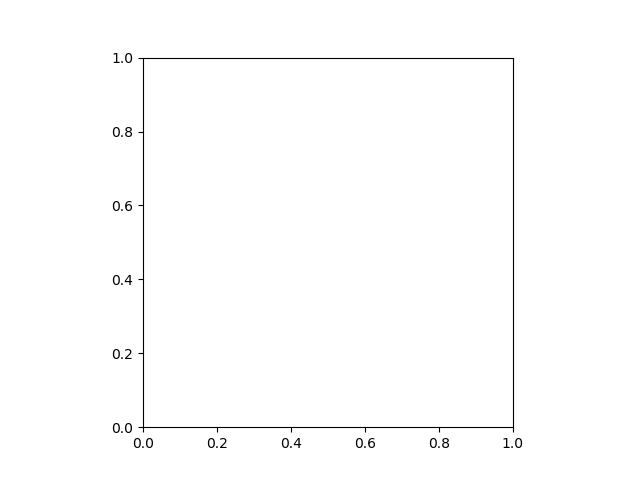

TypeError: Image data of dtype object cannot be converted to float

In [47]:
plt.imshow(label)

In [ ]:
# load the image and grab its width and height
image = cv2.imread(path+filename[1])
(h, w) = image.shape[:2]
 
# convert the image from the RGB color space to the L*a*b*
# color space -- since we will be clustering using k-means
# which is based on the euclidean distance, we'll use the
# L*a*b* color space where the euclidean distance implies
# perceptual meaning
image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
 
# reshape the image into a feature vector so that k-means
# can be applied
image = image.reshape((image.shape[0] * image.shape[1], 3))
 
# apply k-means using the specified number of clusters and
# then create the quantized image based on the predictions
clt = sklearn.cluster.MiniBatchKMeans(n_clusters = 15)
labels = clt.fit_predict(image)
quant = clt.cluster_centers_.astype("uint8")[labels]
 
# reshape the feature vectors to images
quant = quant.reshape((h, w, 3))
image = image.reshape((h, w, 3))
 
# convert from L*a*b* to RGB
quant = cv2.cvtColor(quant, cv2.COLOR_LAB2BGR)
image = cv2.cvtColor(image, cv2.COLOR_LAB2BGR)
 
# display the images and wait for a keypress
cv2.imshow("image", np.hstack([image, quant]))
#cv2.waitKey(0)
cv2.imwrite('segmentationth10.png',quant)

In [48]:
float(len(np.ravel(np.where(label==2))))

0.0

In [49]:
len(np.ravel(np.where(label==2)))


0

In [50]:
result_image = res.reshape((img.shape[0:2]))

NameError: name 'res' is not defined

In [51]:
result_image,label= segmentation(im,1)

<IPython.core.display.Javascript object>

No handles with labels found to put in legend.


In [53]:
segmented

NameError: name 'segmented' is not defined

<IPython.core.display.Javascript object>


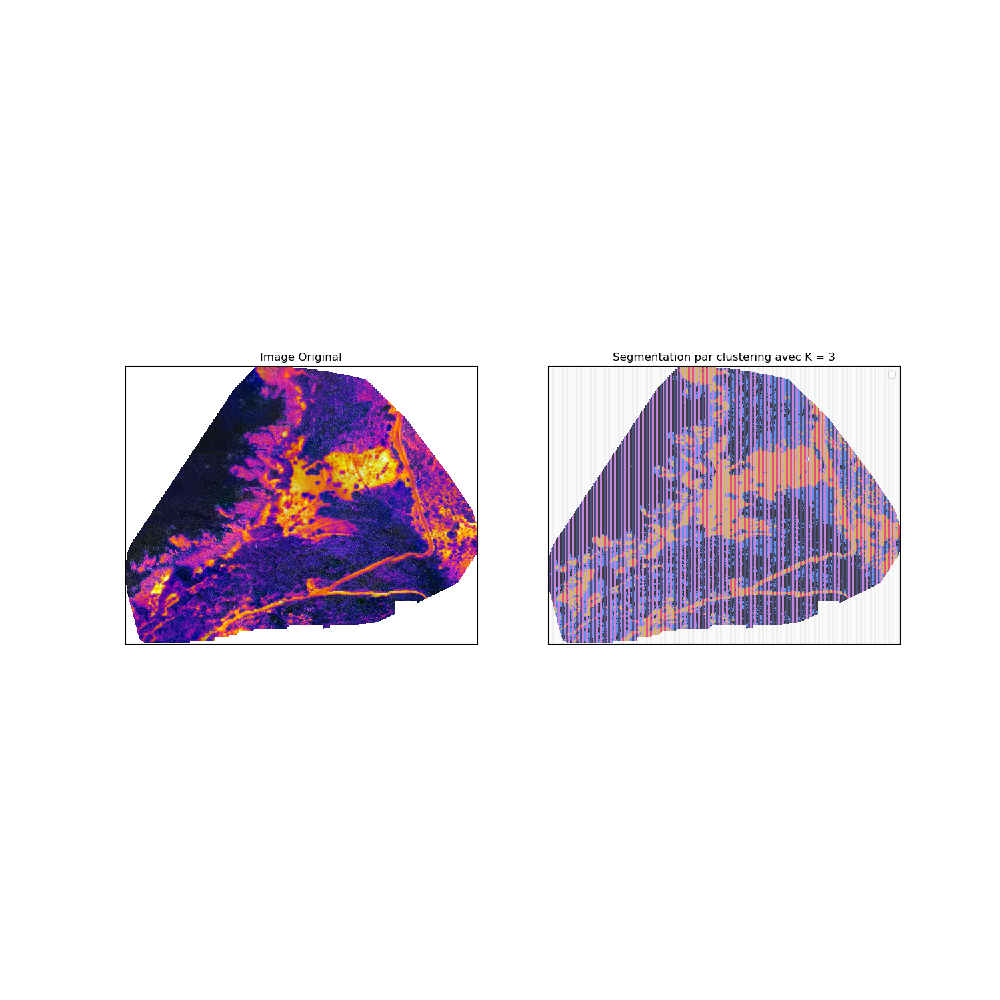

No handles with labels found to put in legend.


In [54]:
test = np.array(im)
result_image,label = segmentation(im,1)

In [57]:
result_image[10000:10020]

array([], shape=(0, 2418, 4), dtype=uint8)

In [58]:
plt.imshow(result_image[10000:10020])
plt.legend()

ValueError: zero-size array to reduction operation minimum which has no identity

In [59]:
np.unique(label)

array([0, 1, 2], dtype=int32)

In [60]:


# find a dividing line between 0 and 255
# pixels below this value will be black
# pixels above this value will be white
val = filters.threshold_otsu(matrice_g)

# the mask object converts each pixel in the image to True or False
# to indicate whether the given pixel is black/white
mask = im_g < val

# apply the mask to the image object
clean_border = segmentation.clear_border(mask)

# plot the resulting binarized image
plt.imshow(clean_border, cmap='gray')


AttributeError: 'function' object has no attribute 'clear_border'

In [61]:
np.unique(clean_border)

NameError: name 'clean_border' is not defined

In [62]:
# labeled contains one integer for each pixel in the image,
# where that image indicates the segment to which the pixel belongs
labeled = label(clean_border)
plt.imshow(labeled)

NameError: name 'clean_border' is not defined

In [63]:
im = Image.open(path+filename[0])

In [64]:
opt = pd.DataFrame(np.ravel(im))
sns.distplot(opt)

In [65]:
opt.describe()

,0
count,1.502943e+08
mean,1.175155e+02
std,9.375597e+01
min,0.000000e+00
25%,0.000000e+00
50%,1.200000e+02
75%,1.940000e+02
max,2.550000e+02


In [66]:
opt = np.float32(pd.DataFrame(np.ravel(im)))

In [67]:
opt_hsv = np.float32(pd.DataFrame(np.ravel(im_hsv)))

In [68]:
matrice_im.shape

(1907, 2418, 4)

In [70]:
K = 4
attempts = 10 
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
ret, label, center = cv2.kmeans(opt_hsv, K, None, criteria, attempts, cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]

In [71]:
K = 4
attempts = 10 
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
ret, label, center = cv2.kmeans(opt, K, None, criteria, attempts, cv2.KMEANS_PP_CENTERS)
center = np.uint8(center)
res = center[label.flatten()]

In [72]:
result_im = res.reshape(matrice_im.shape)

ValueError: cannot reshape array of size 150294300 into shape (1907,2418,4)

In [ ]:
plt.imshow(result_im)

In [ ]:
pixels_classe_zb = np.where(label == 0)
nombre_ = len(pixels_classe_zb)

# Proportion of the different colors 

In [ ]:
img = np.array(Image.open(path+filename[0]))
im_hsv = np.array(im.convert('HSV'))
#matrice_hsv = np.array(im_hsv)

In [ ]:
# pixels is the 1D array, results of the img flattening process (made by reshape function)
pixels = np.float32(img.reshape(-1, 3))
print("Pixel shape = ", pixels.shape)
 
# Here is the number of colors we are trying to detect.
n_colors = 5
 
# Opencv kmeans parameters (See the following URL for more information: 
# https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_ml/py_kmeans/py_kmeans_opencv/py_kmeans_opencv.html
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 200, .1)
flags = cv2.KMEANS_RANDOM_CENTERS
 
# palette represents clusters centers
# Labels represents the cluster labels.
#   As we have 5 colors, labels are 0,1,2,3,4 
_, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
# And counts represents the number of occurence for each label
_, counts = np.unique(labels, return_counts=True)
 
# Our dominant color is the color that have the maximum number of occurence in the "counts" array
dominant = palette[np.argmax(counts)]
print("dominant color (RVB) =",dominant)


In [ ]:
import matplotlib as mpl
%matplotlib notebook
from matplotlib import pyplot as plt
 
indices = np.argsort(counts)[::-1]  
freqs = np.cumsum(np.hstack([[0], counts[indices]/counts.sum()]))
rows = np.int_(img.shape[0]*freqs)
 
dom_patch = np.zeros(shape=img.shape, dtype=np.uint8)
main_patch=np.ones(shape=img.shape, dtype=np.uint8)*np.uint8(palette[indices[0]])
second_patch=np.ones(shape=img.shape, dtype=np.uint8)*np.uint8(palette[indices[1]])
 
for i in range(len(rows) - 1):
    dom_patch[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])
 
fig, (ax0, ax1, ax2, ax3 ) = plt.subplots(1, 4 , figsize=(9,6))
ax0.imshow(img)
ax0.set_title('Original')
ax0.axis('off')
 
ax1.imshow(dom_patch)
ax1.set_title('Dominant colors')
ax1.yaxis.set_major_locator(plt.NullLocator())
ax1.xaxis.set_major_locator(plt.NullLocator())
 
ax2.imshow(main_patch)
ax2.set_title('Main color')
ax2.yaxis.set_major_locator(plt.NullLocator())
ax2.xaxis.set_major_locator(plt.NullLocator())
 
ax3.imshow(second_patch)
ax3.set_title('Second color')
ax3.yaxis.set_major_locator(plt.NullLocator())
ax3.xaxis.set_major_locator(plt.NullLocator())
                                                                                                               
plt.show(fig) 


In [ ]:
img = np.array(im.convert('HSV'))
import cv2
 
# pixels is the 1D array, results of the img flattening process (made by reshape function)
pixels = np.float32(img.reshape(-1, 3))
print("Pixel shape = ", pixels.shape)
 
# Here is the number of colors we are trying to detect.
n_colors = 5
 
# Opencv kmeans parameters (See the following URL for more information: 
# https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_ml/py_kmeans/py_kmeans_opencv/py_kmeans_opencv.html
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 200, .1)
flags = cv2.KMEANS_RANDOM_CENTERS
 
# palette represents clusters centers
# Labels represents the cluster labels.
#   As we have 5 colors, labels are 0,1,2,3,4 
_, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
# And counts represents the number of occurence for each label
_, counts = np.unique(labels, return_counts=True)
 
# Our dominant color is the color that have the maximum number of occurence in the "counts" array
dominant = palette[np.argmax(counts)]
print("dominant color (HSV) =",dominant)


In [15]:
%matplotlib notebook
 
indices = np.argsort(counts)[::-1]  
freqs = np.cumsum(np.hstack([[0], counts[indices]/counts.sum()]))
rows = np.int_(img.shape[0]*freqs)
 
dom_patch = np.zeros(shape=img.shape, dtype=np.uint8)
main_patch=np.ones(shape=img.shape, dtype=np.uint8)*np.uint8(palette[indices[0]])
second_patch=np.ones(shape=img.shape, dtype=np.uint8)*np.uint8(palette[indices[1]])
 
for i in range(len(rows) - 1):
    dom_patch[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])
 
fig, (ax0, ax1, ax2, ax3 ) = plt.subplots(1, 4 , figsize=(9,6))
ax0.imshow(img)
ax0.set_title('Original')
ax0.axis('off')
 
ax1.imshow(dom_patch)
ax1.set_title('Dominant colors')
ax1.yaxis.set_major_locator(plt.NullLocator())
ax1.xaxis.set_major_locator(plt.NullLocator())
 
ax2.imshow(main_patch)
ax2.set_title('Main color')
ax2.yaxis.set_major_locator(plt.NullLocator())
ax2.xaxis.set_major_locator(plt.NullLocator())
 
ax3.imshow(second_patch)
ax3.set_title('Second color')
ax3.yaxis.set_major_locator(plt.NullLocator())
ax3.xaxis.set_major_locator(plt.NullLocator())
                                                                                                               
plt.show(fig) 


NameError: name 'counts' is not defined